Author : Himanshu Gullaiya <br>
Source : Pierian Data

### Section Goals
    -> Various Image Processing Operations
    -> Smoothing, Blurring, Morphological Operations
    -> Color Spaces & Histograms

RGB alternatives: <br>
    **HSL** (Hue, Saturation, Lightness) <br>
    **HSV** (Hue, Saturation, Value) <br>
    HSL,HSV are more how human percieves Vision

In [1]:
# %matplotlib qt
%matplotlib inline
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [318]:
img1 = cv2.imread("../DATA/dog_backpack.png")
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

In [319]:
# img1 = cv2.resize(img1, (0,0), fx = 0.5, fy = 0.5)

In [320]:
img2 = cv2.imread("../DATA/watermark_no_copy.png")
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
# img2 = cv2.resize(img2, (467,700))

### Theoretical Approach

In [321]:
alpha = 0.8
beta = 0.1
gamma = 10

In [ ]:
img3 = alpha*img1 + beta*img2 +  gamma

In [ ]:
print(img3.shape, img2.shape, img1.shape)

In [ ]:
img3 = np.array(img3, dtype = np.int16)

In [ ]:
plt.figure()
plt.imshow(img3)

### CV2 Function

In [ ]:
blended = cv2.addWeighted(src1 = img1, alpha = 0.8, src2 = img2, beta = 0.1, gamma = 10)

In [ ]:
plt.imshow(blended)

### Blending one image onto another

In [ ]:
img1 = cv2.imread("../DATA/dog_backpack.png")
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

In [ ]:
img1 = cv2.resize(img1, (0,0), fx = 0.7, fy = 0.7)

In [ ]:
img2 = cv2.imread("../DATA/watermark_no_copy.png")
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

#### Function to Get Coordinates (X,Y) to add second image onto

In [ ]:
def positions(event,x,y,flags,param):
    if event == cv2.EVENT_LBUTTONDOWN:
        print(x,y)

In [ ]:
cv2.namedWindow(winname = "Photo")
cv2.setMouseCallback("Photo", positions)
while True:
    cv2.imshow('Photo',overlayed)
    if cv2.waitKey() in (ord('q'), 27):
        break
cv2.destroyAllWindows()

#### Theoretical Approach

In [ ]:
width = 510 - 320
height = 820 - 680

In [ ]:
cropped = cv2.resize(img2, (width, height), interpolation=cv2.INTER_LANCZOS4)

In [ ]:
cropped = cv2.GaussianBlur(cropped, (3,3),0)
plt.imshow(cropped)

In [ ]:
overlayed = img1
plt.imshow(overlayed)

In [ ]:
for x in range(height):
    for y in range(width):
        if (cropped[x][y] != [255,255,255]).all():
            overlayed[690+x][315+y] = cropped[x][y]

In [ ]:
# overlayed[690:690+height,315:315+width] = cropped

In [ ]:
plt.imshow(overlayed[690:690+height-1,315:315+width-1])

In [ ]:
for_cv = cv2.cvtColor(overlayed, cv2.COLOR_RGB2BGR)

In [362]:
cv2.imshow("Blended Image",for_cv)
if cv2.waitKey() in (ord('q'), 27):
    cv2.destroyAllWindows()


#### ===============================================================================

In [ ]:
fig, axs = plt.subplots(2,2, figsize = (10,8))
axs[0,0].imshow(overlayed)
axs[0,0].title.set_text("Orginal Image")
axs[0,1].imshow(overlayed[:,:,0], cmap = 'gray')
axs[0,1].title.set_text("Red Channel")
axs[1,0].imshow(overlayed[:,:,1], cmap = 'gray')
axs[1,0].title.set_text("Green Channel")
axs[1,1].imshow(overlayed[:,:,2], cmap = 'gray')
axs[1,1].title.set_text("Blue Channel")

#### Creating a Mask

In [367]:
img2gray = cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)

In [370]:
plt.imshow(img2gray)

In [354]:
mask_inv = cv2.bitwise_not(img2gray)
mask_inv_3_channel = np.full(img2.shape, 255,dtype = np.int16)

In [357]:
bk = cv2.bitwise_or(mask_inv_3_channel,mask_inv_3_channel, mask = mask_inv)

### Image Thresholding

In [44]:
img = cv2.imread("../DATA/rainbow.jpg",0)

In [45]:
fg = plt.figure()
plt.imshow(img, cmap = "gray")
fg.show()

In [50]:
ret,thresh1 = cv2.threshold(img,128, 255, cv2.THRESH_TOZERO)

In [51]:
fg1 = plt.figure()
plt.imshow(thresh1, cmap = "gray")
fg1.show()

**Example 2**

In [55]:
img = cv2.imread("../DATA/crossword.jpg",0)

In [56]:
fg = plt.figure()
plt.imshow(img, cmap = "gray")
fg.show()

In [65]:
def show_pic(img):
    fig = plt.figure(figsize = (20,20))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap = "gray")

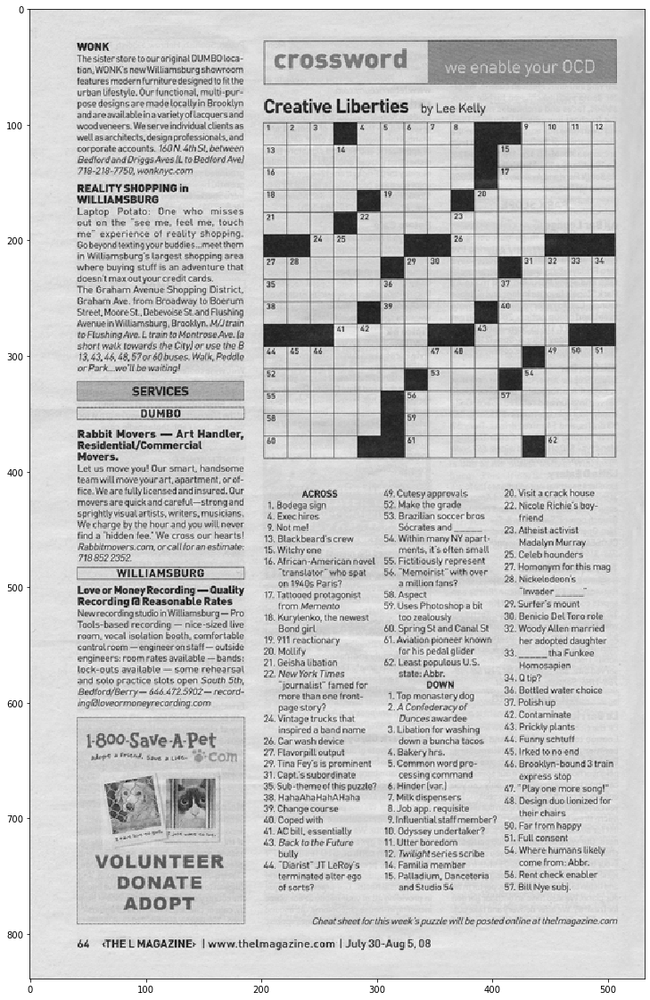

In [66]:
show_pic(img)

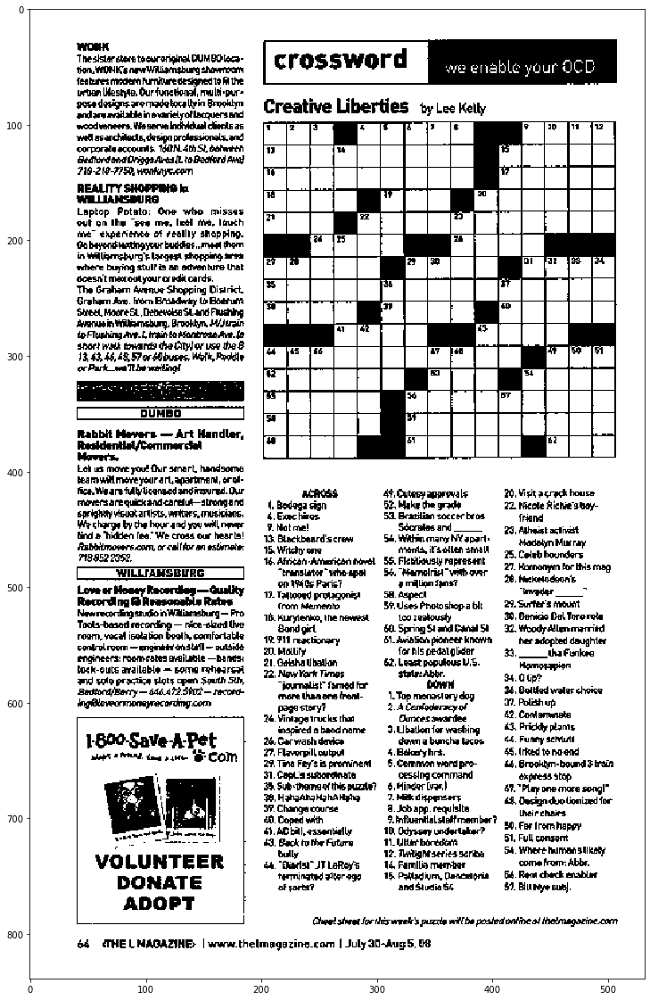

In [109]:
rec,t1 = cv2.threshold(img, 180, 255, cv2.THRESH_BINARY)
show_pic(t1)

In [131]:
t2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11,  12)

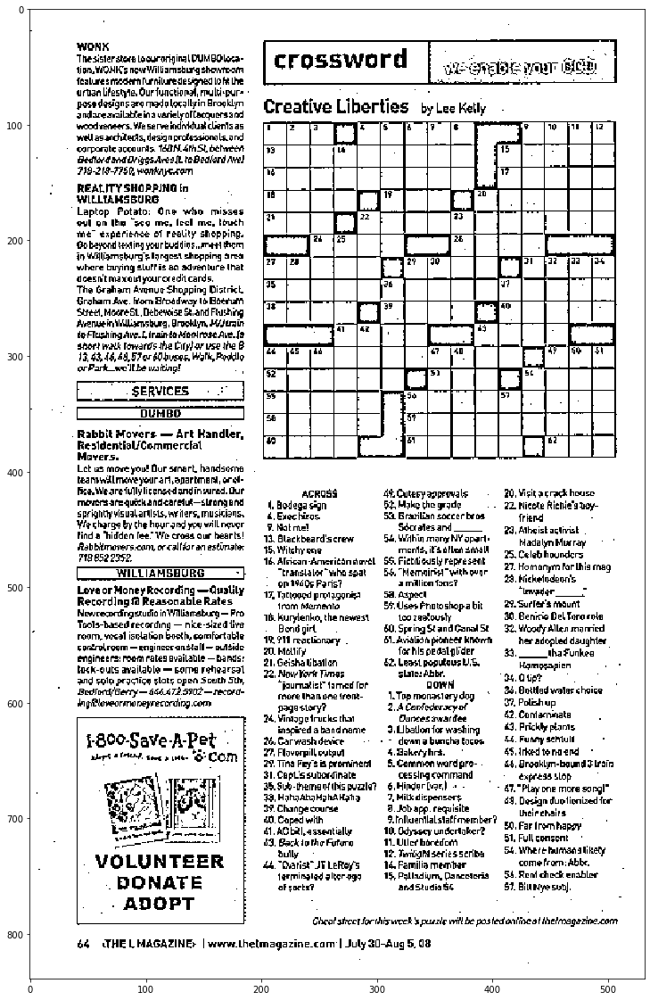

In [132]:
show_pic(t2)

In [126]:
blended = cv2.addWeighted(src1 = t1, alpha = 0.4, src2 = t2, beta = 0.6, gamma = 0)

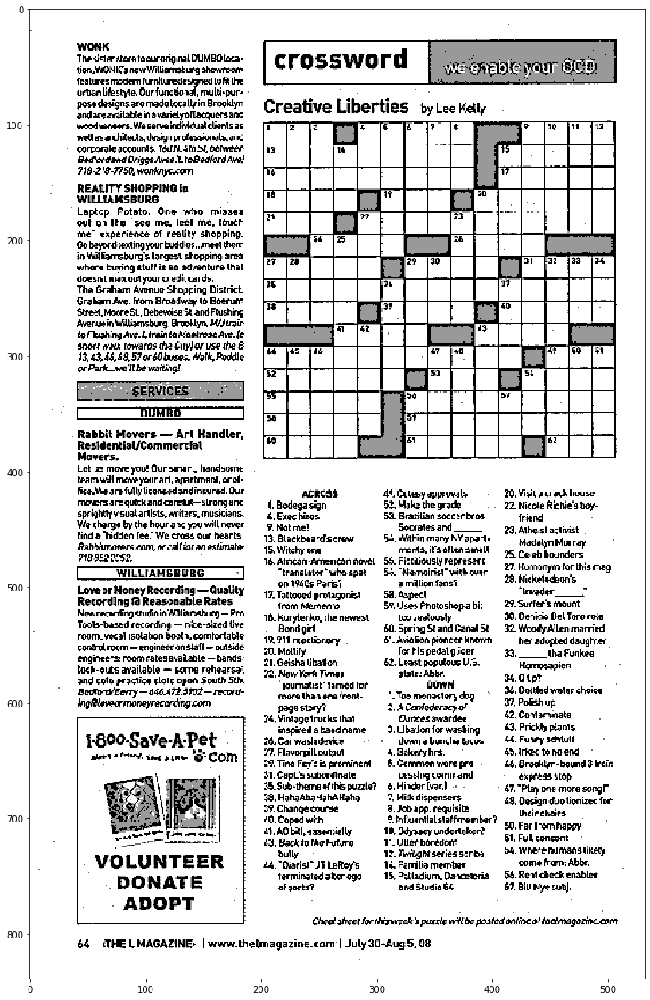

In [133]:
show_pic(blended)

In [137]:
[i for i in dir(cv2) if 'EVENT' in  i]

['EVENT_FLAG_ALTKEY',
 'EVENT_FLAG_CTRLKEY',
 'EVENT_FLAG_LBUTTON',
 'EVENT_FLAG_MBUTTON',
 'EVENT_FLAG_RBUTTON',
 'EVENT_FLAG_SHIFTKEY',
 'EVENT_LBUTTONDBLCLK',
 'EVENT_LBUTTONDOWN',
 'EVENT_LBUTTONUP',
 'EVENT_MBUTTONDBLCLK',
 'EVENT_MBUTTONDOWN',
 'EVENT_MBUTTONUP',
 'EVENT_MOUSEHWHEEL',
 'EVENT_MOUSEMOVE',
 'EVENT_MOUSEWHEEL',
 'EVENT_RBUTTONDBLCLK',
 'EVENT_RBUTTONDOWN',
 'EVENT_RBUTTONUP']

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
def load_img():
    img = cv2.imread('../DATA/bricks.jpg').astype(np.float32)/255  # img should have values (0-1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
    return img
    

In [12]:
def display_img(img):
    fig = plt.figure(figsize = (20,20))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap = "gray")

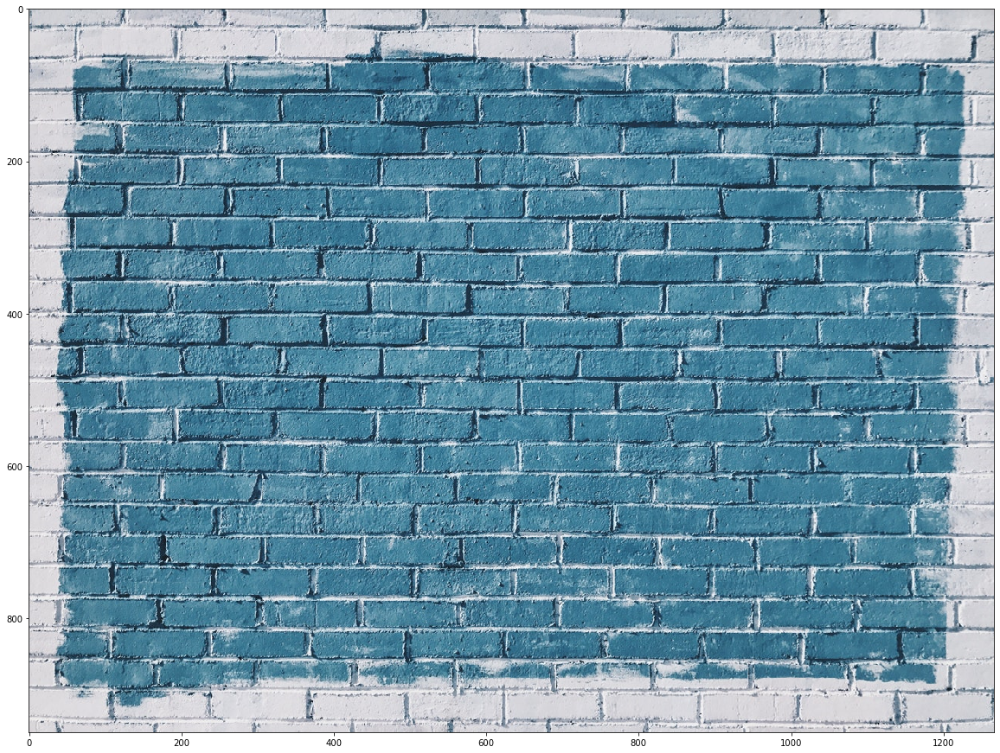

In [13]:
img = load_img()
display_img(img)

**GAMMA CORRECTION**

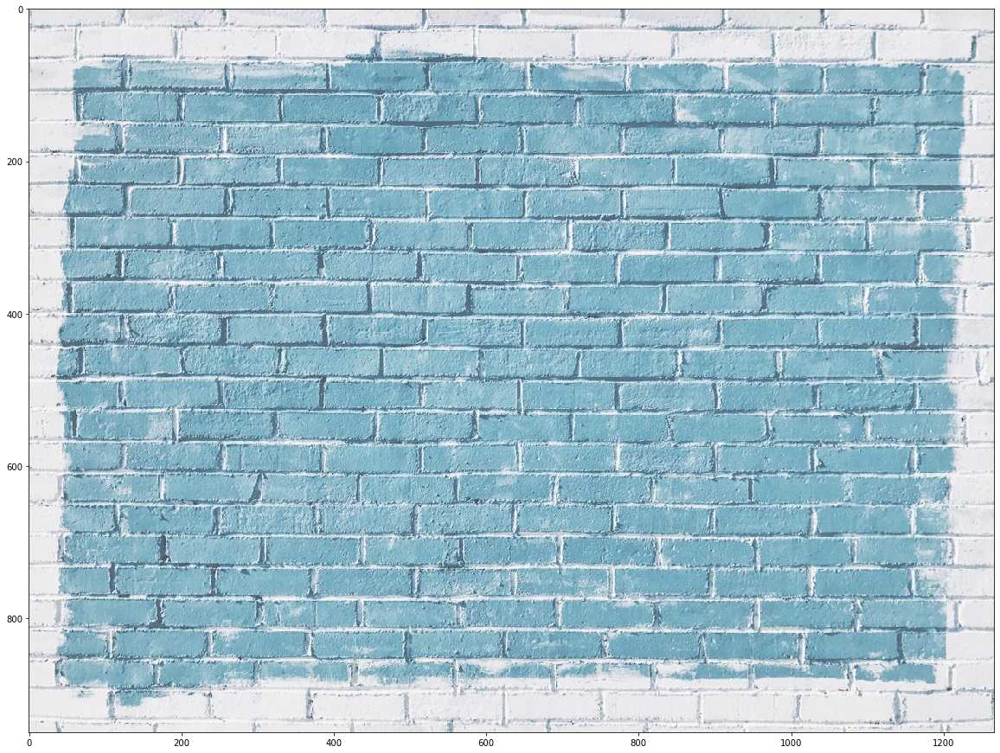

In [14]:
gamma = 1/2  # gamma < 1 : Lighter , else brighter
result = np.power(img, gamma)
display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


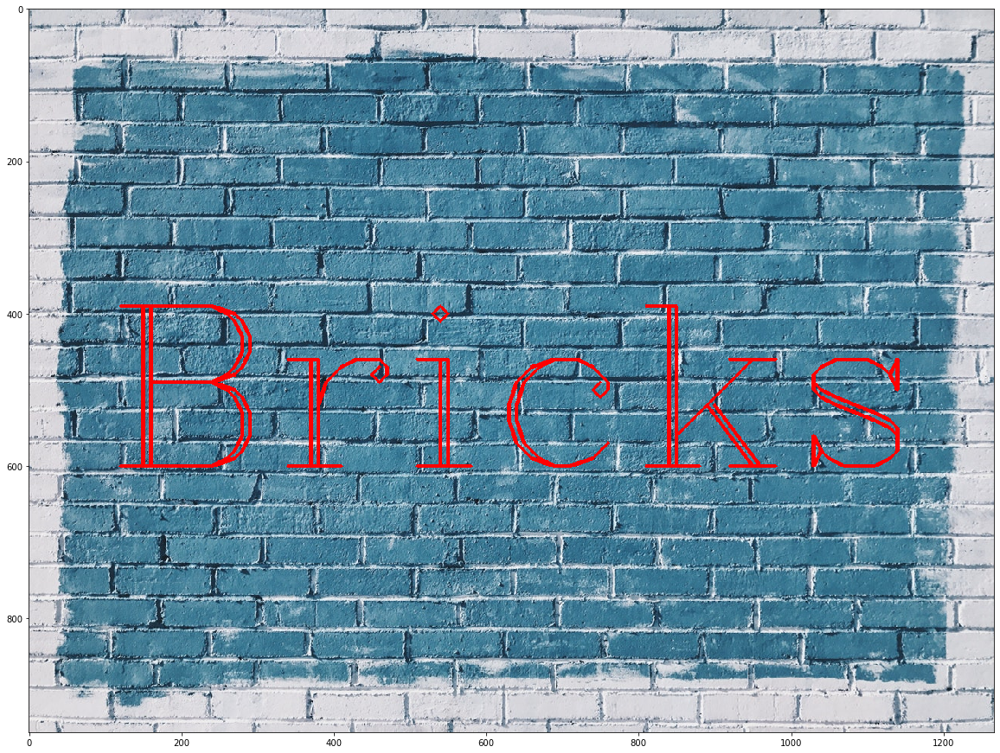

In [15]:
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (100,600),fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

In [30]:
kernel = np.ones(shape = (5,5), dtype = np.float32)/25

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


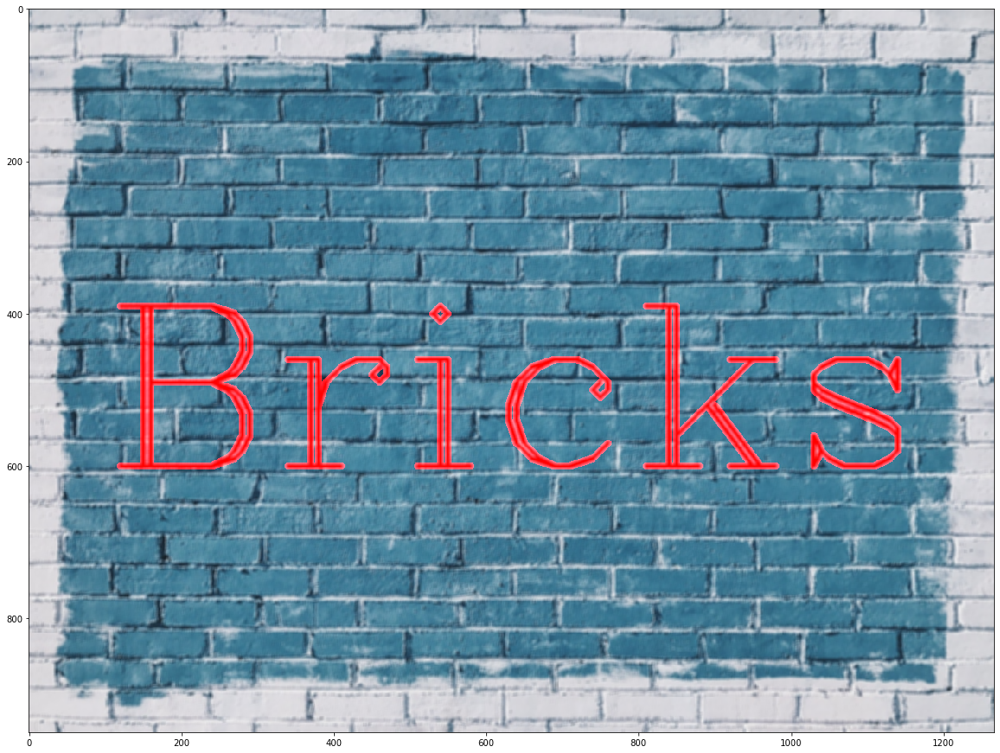

In [31]:
dst = cv2.filter2D(img, -1, kernel)
display_img(dst)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


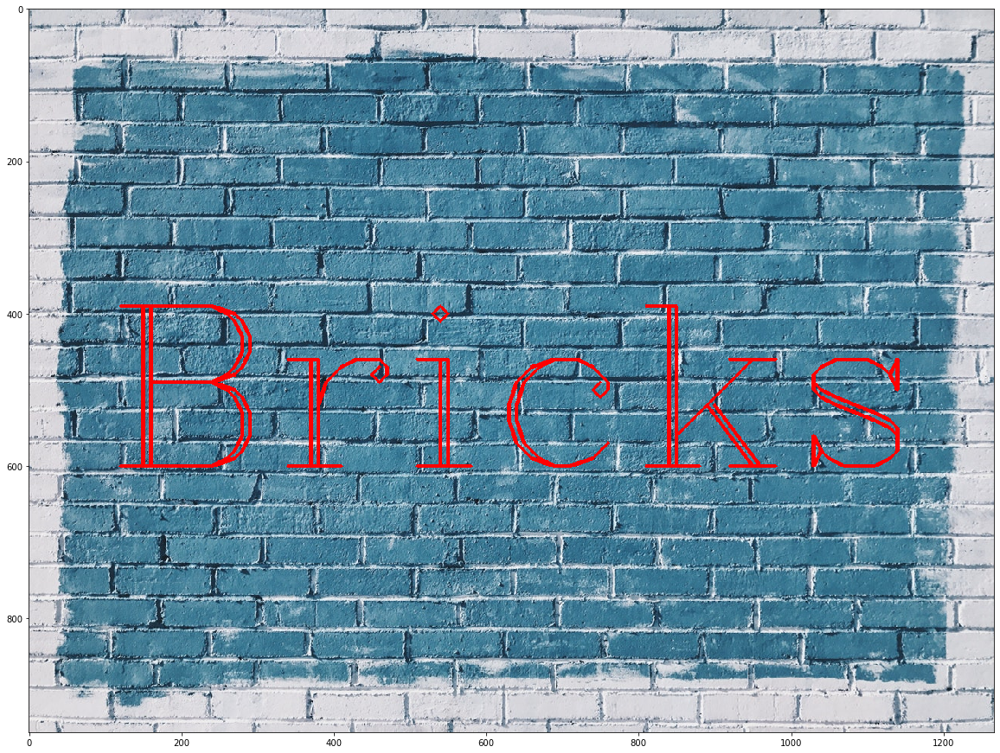

In [21]:
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (100,600),fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


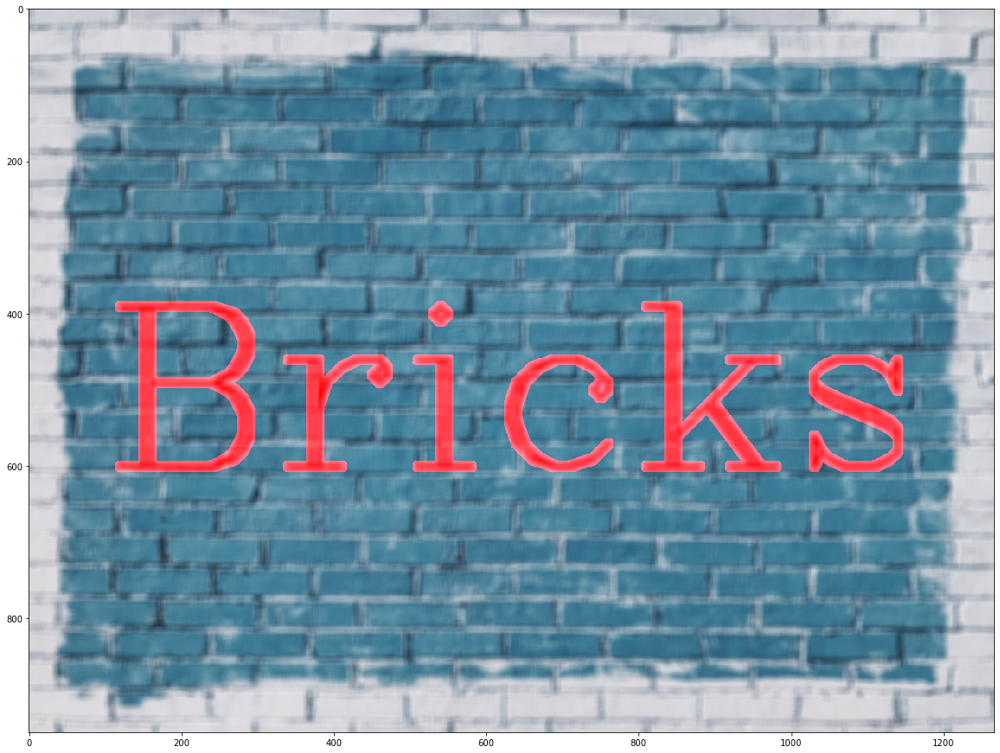

In [33]:
blurred = cv2.blur(img, ksize = (10,10))
display_img(blurred)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


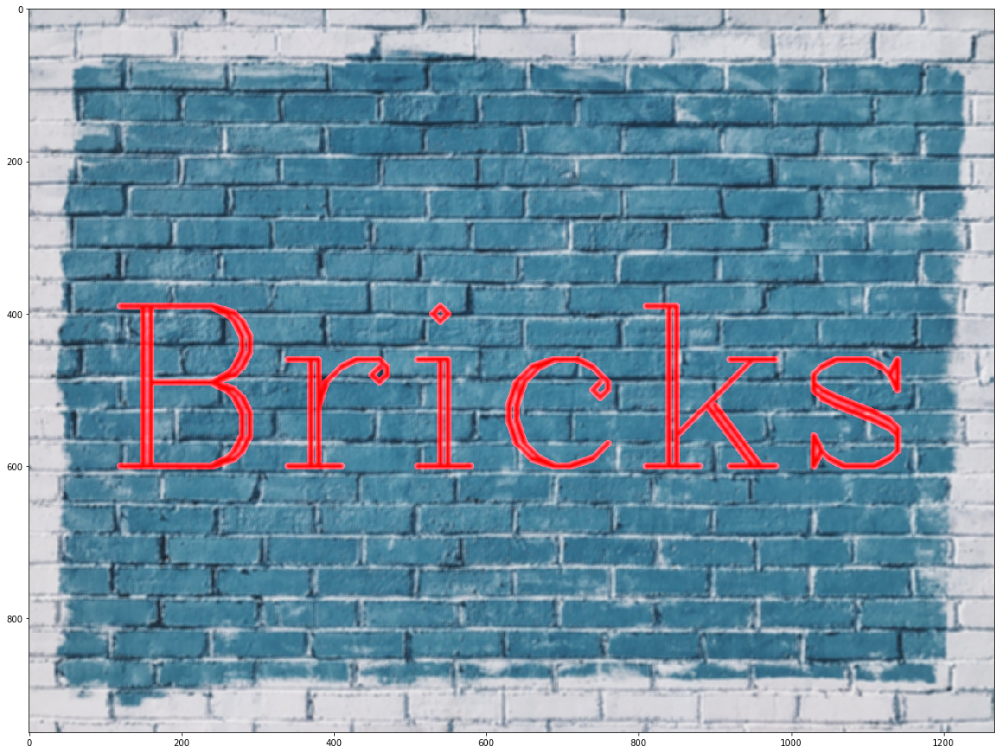

In [35]:
blurred2 = cv2.GaussianBlur(img, (5,5), 10)  # (img, kernel_size, sigma_value)
display_img(blurred2)

#### Median Blur is Effective in keeping Details while Blurring Noise

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


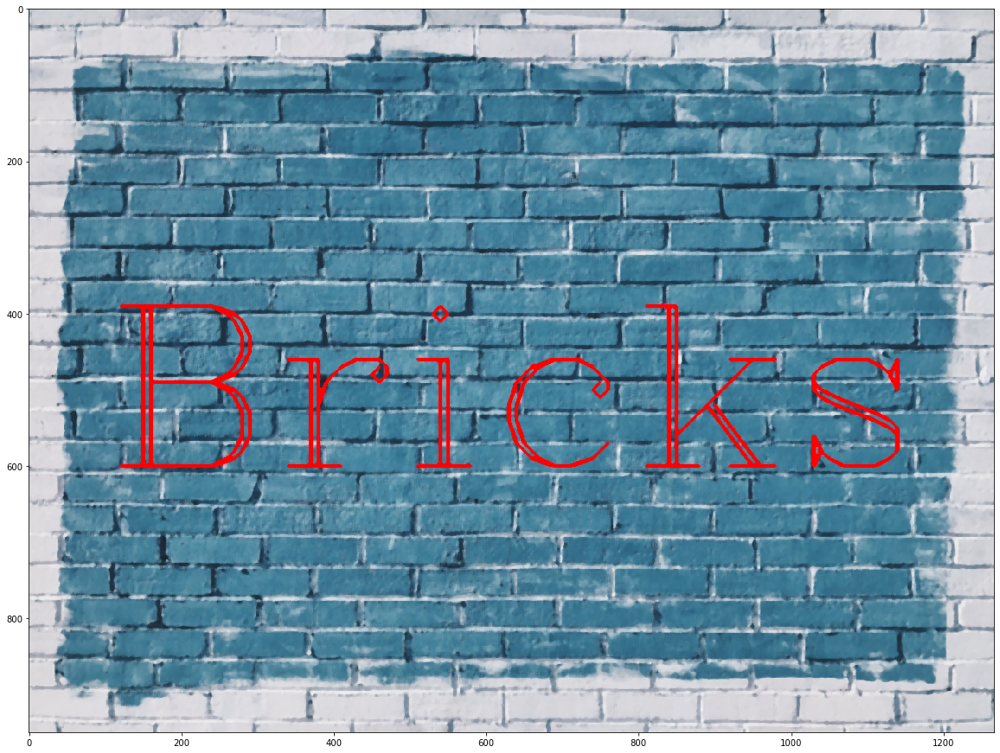

In [39]:
median_results = cv2.medianBlur(img, 5)
display_img(median_results)

### Morphology

#### Morphological Operators
*Four Types of M. Operators: Erosion, Dilation, Opening, Closing*    
*Opening: Dilation on Erosion*   
*Closing: Erosion on Dilation*   

These operators are sets of Kernels that can achieve a variety of effects, such as Reducing Noise. Certain Operators are very good at reducing black points on a white Background & vice-versa

Certain Operators can also achieve an erosion & dilation effect, this is more easily seen on text data.

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [93]:
def load_img():
    blank_img = np.zeros((300,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img, text = 'ABCDE', org = (50,190), fontFace=font, fontScale = 5, color = (255,255,255), thickness = 25)
    return blank_img

In [94]:
def display_img(img):
    fig = plt.figure(figsize = (15,12))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap = 'gray')

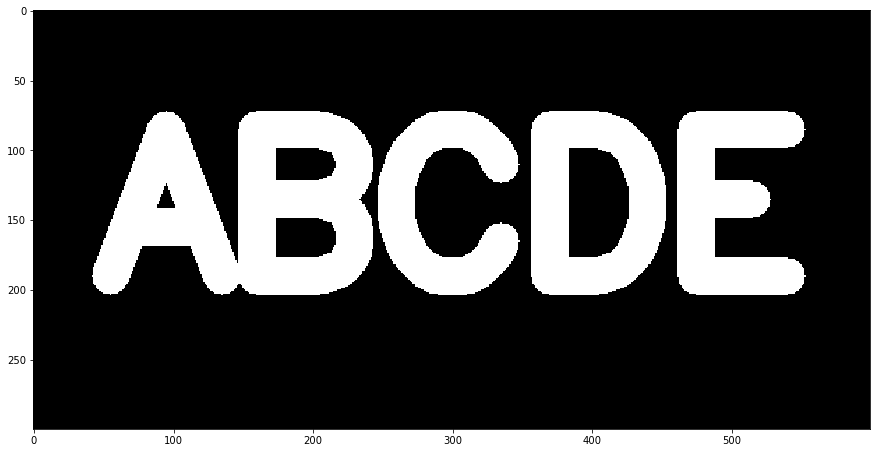

In [81]:
img = load_img()
display_img(img)

### EROSION

In [82]:
kernel = np.ones((5,5), dtype = np.uint8)

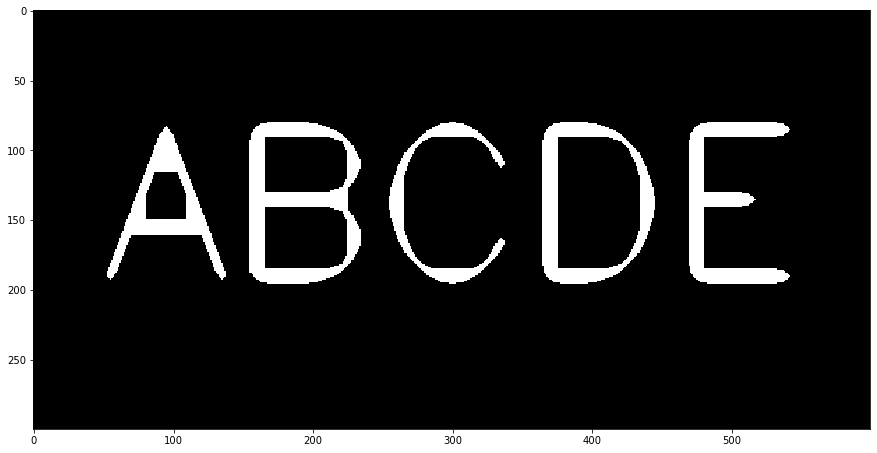

In [83]:
result = cv2.erode(img, kernel, iterations = 4)
display_img(result)

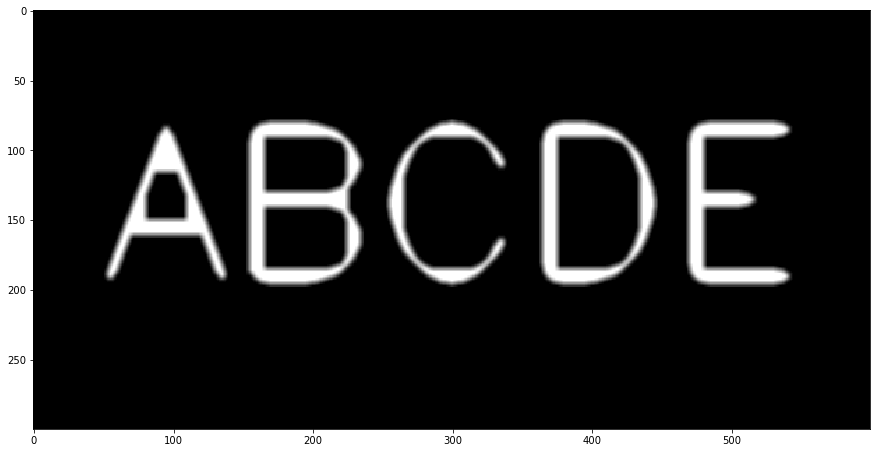

In [92]:
blurred = cv2.blur(result, (5,5))
display_img(blurred)

### OPENING = EROSION + DILATION

Useful in Removing **Background & Foreground Noise**

### Background Noise Removal Example

In [ ]:
img = load_img()

In [104]:
white_noise = np.random.randint(low = 0, high = 2, size = (300,600))

In [105]:
white_noise *= 255

In [ ]:
noisy_image = img + white_noise
print(noisy_image.min())
print(noisy_image.max())

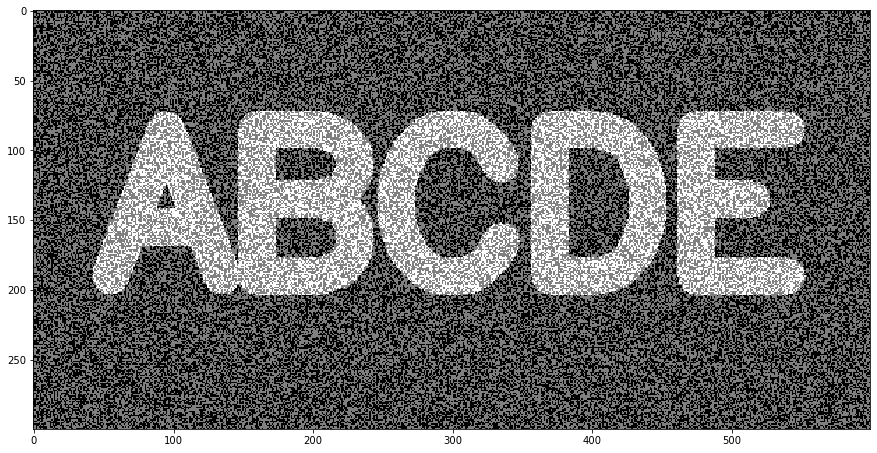

In [106]:
display_img(noisy_image)

In [111]:
opening = cv2.morphologyEx(noisy_image, cv2.MORPH_OPEN, kernel )

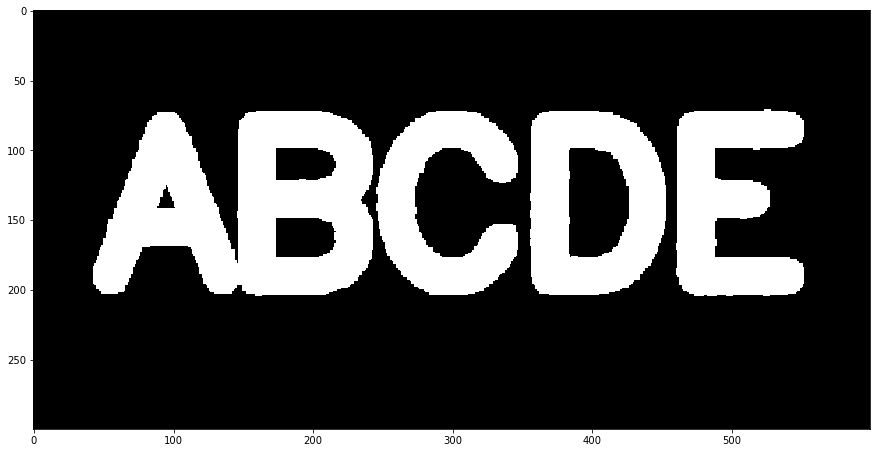

In [128]:
display_img(opening)

### Foreground Noise Removal Example

In [113]:
img = load_img()

In [115]:
black_noise = np.random.randint(low = 0, high = 2, size = (300,600))

In [116]:
black_noise *= -255

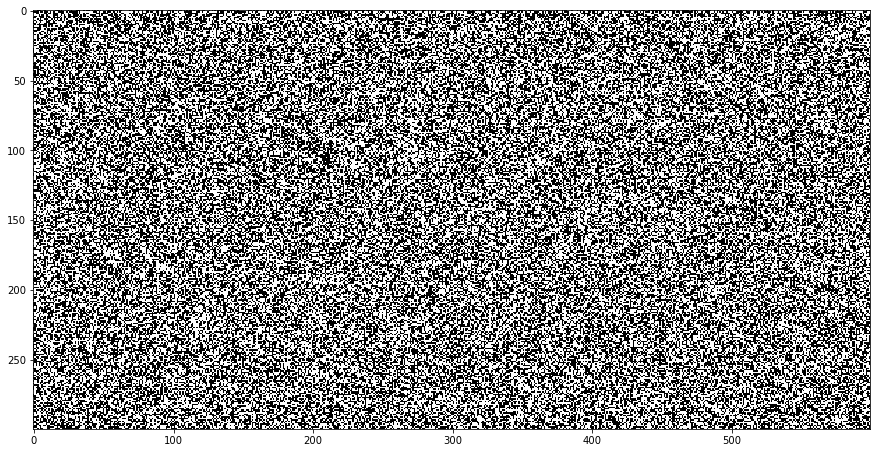

In [117]:
display_img(black_noise)

In [121]:
black_noise_img = img + black_noise

In [123]:
print(black_noise_img.min())
print(black_noise_img.max())

-255.0
255.0


*Wherever, there was black in original image value - (0), and after adding black noise it changed to -255, change it back to 0*

In [124]:
black_noise_img[black_noise_img == -255] = 0

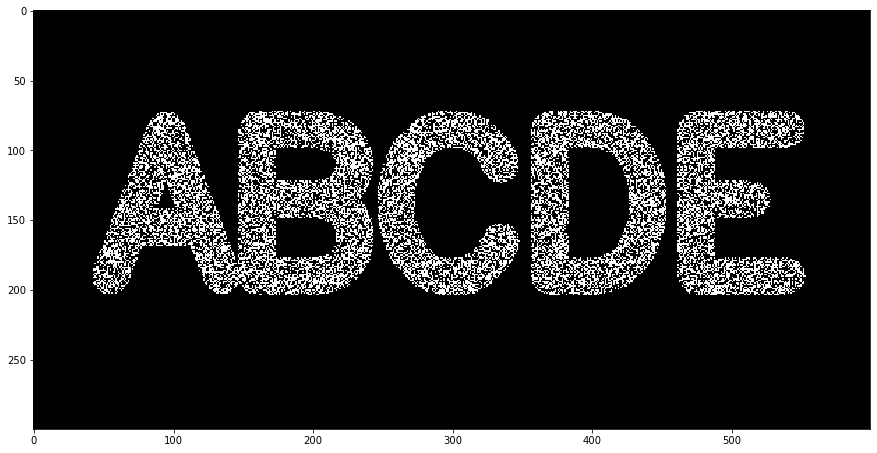

In [125]:
display_img(black_noise_img)

In [ ]:
kernel = np.ones((5,5), dtype = np.uint8)

In [139]:
closing2 = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)

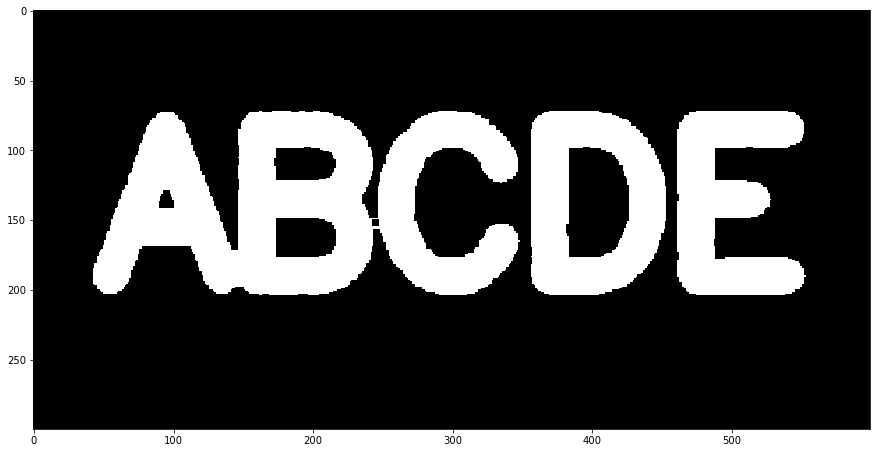

In [140]:
display_img(closing2)

### GRADIENT - Used for Edge Detection

#### Theoretical Approach : Using Erosion & Dilation

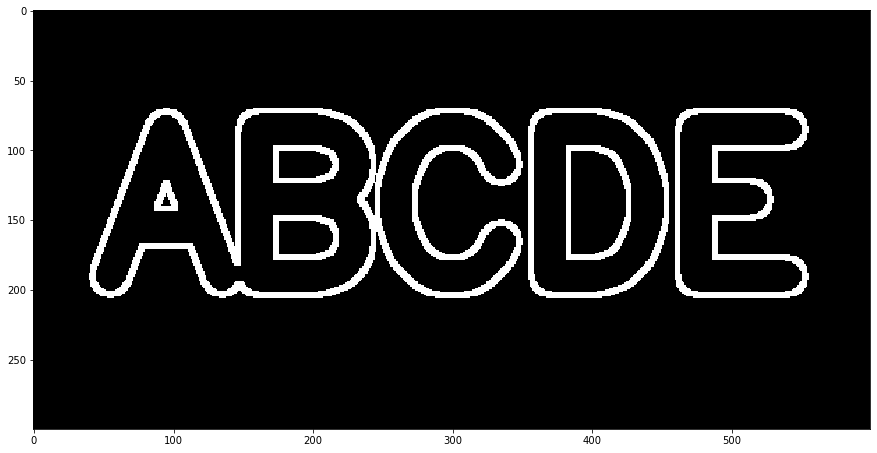

In [203]:
modify = cv2.erode(img, kernel, iterations = 1) - cv2.dilate(img, kernel, iterations = 1)
modify[modify == 0] = 255
modify[modify == -255] = 0
modify = cv2.bitwise_not(modify)
display_img(modify)

#### Using OpenCV

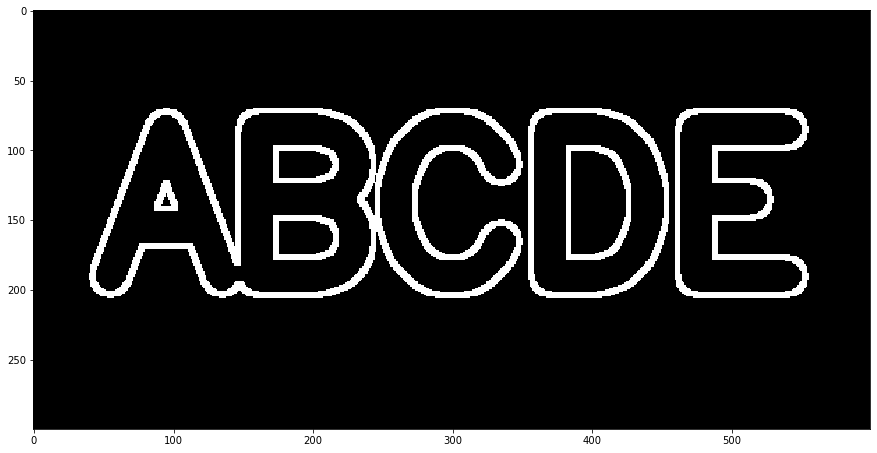

In [204]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
display_img(gradient)

### Gradients

Used for Edge Detection   
**Sobel-Feldman** Operators     

   **Gx**    
| +1 0 -1 |     
| +2 0 -2 |    
| +1 0 -1 |

   **Gy**    
| +1 +2 +1 |     
| 0  0   0 |       
| -1 -2 -1 |


In [1]:
 import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
img = cv2.imread('../DATA/sudoku.jpg',0)

In [28]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

In [ ]:
display_img(img)

**DEPTH** https://stackoverflow.com/questions/32602018/what-is-depth-in-image-processing

In [17]:
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize = 5)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize = 5)

In [18]:
merge = cv2.addWeighted(src1=sobelx,alpha=0.5,src2=sobely,beta=0.5,gamma=0)

In [47]:
ret,thres_img = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)
ret,thres_img1 = cv2.threshold(img, 0, 255, cv2.THRESH_OTSU)

**Laplacian**

In [ ]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)

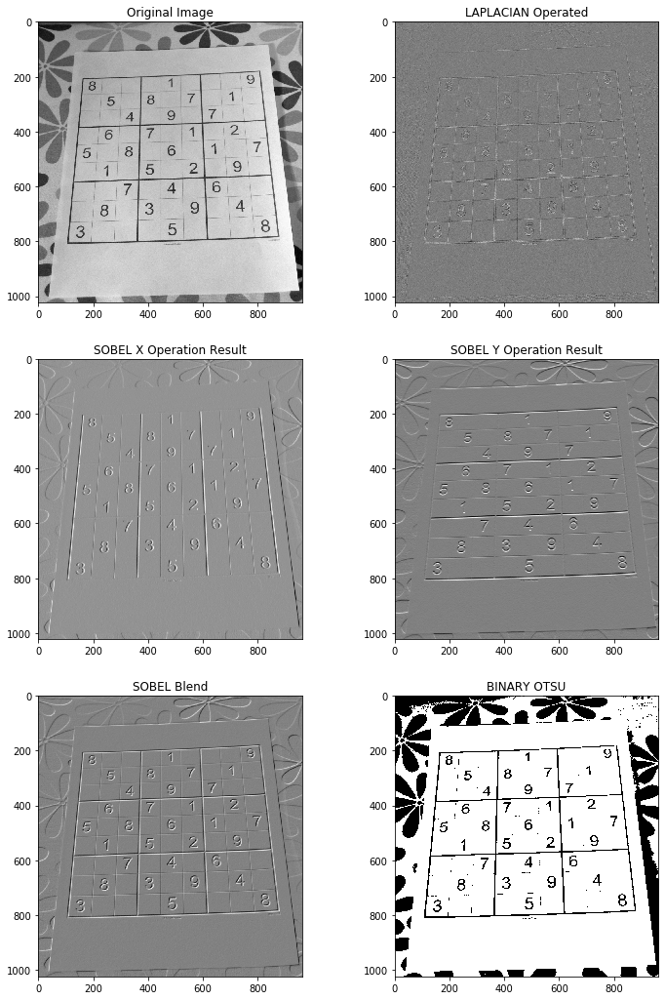

In [67]:
fig, axs = plt.subplots(3,2, figsize = (12,18))

axs[0,0].imshow(img, cmap = "gray")
axs[0,0].title.set_text("Original Image")

axs[0,1].imshow(laplacian, cmap = "gray")
axs[0,1].title.set_text("LAPLACIAN Operated")

axs[1,0].imshow(sobelx, cmap = "gray")
axs[1,0].title.set_text("SOBEL X Operation Result")

axs[1,1].imshow(sobely, cmap = "gray")
axs[1,1].title.set_text("SOBEL Y Operation Result")

axs[2,0].imshow(merge, cmap = "gray")
axs[2,0].title.set_text("SOBEL Blend")

axs[2,1].imshow(thres_img1, cmap = "gray")
axs[2,1].title.set_text("BINARY OTSU")

In [68]:
# Gradient

In [53]:
kernel = np.ones((4,4), dtype = np.uint8)

In [58]:
gradient = cv2.morphologyEx(merge, cv2.MORPH_GRADIENT, kernel)

In [ ]:
display_img(gradient)

### Histograms

Default Color Mapping Format for OpenCV: **BGR**

In [69]:
dark_horse = cv2.imread('../DATA/horse.jpg')
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('../DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('../DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

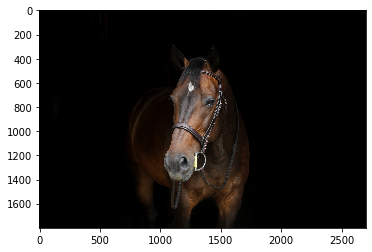

In [70]:
plt.imshow(show_horse)

In [86]:
hist_values = cv2.calcHist([dark_horse],channels=[0],mask=None,histSize=[256],ranges=[0,256]) #channels = BGR

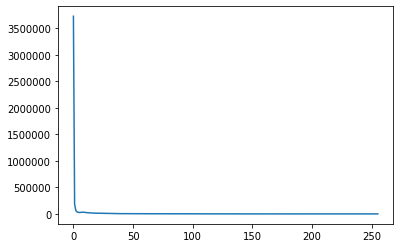

In [87]:
plt.plot(hist_values)

In [122]:
import seaborn as sns

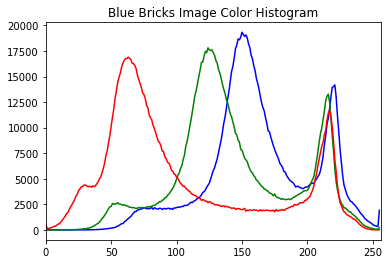

In [156]:
img = blue_bricks
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Blue Bricks Image Color Histogram')
plt.show()

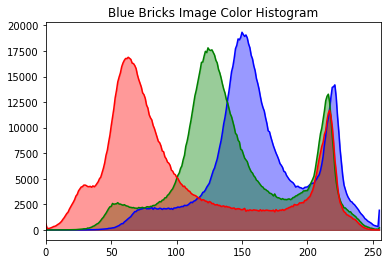

In [200]:
img = blue_bricks
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256]).flatten()
    indices = np.arange(0, len(histr)).flatten()
    plt.plot(indices,histr,color = col)
    plt.xlim([0,256])
    plt.fill_between(indices, histr, color = col, alpha = 0.4)
plt.title('Blue Bricks Image Color Histogram')
plt.show()

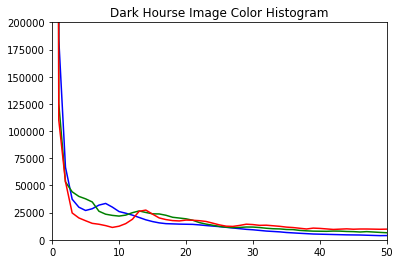

In [133]:
img = dark_horse
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,50])
    plt.ylim([0,200000])
plt.title('Dark Hourse Image Color Histogram')
plt.show()

#### Histogram Equilization
It is a method of increasing or decreasing the **contrast** of an image using adjustments based on image's histogram.

In [ ]:
rainbow = cv2.imread('../DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [279]:
img = rainbow


0

In [287]:
mask = np.zeros(img.shape[:2], np.uint8)
mask[300:400, 100:400] = 255

In [288]:
masked_img = cv2.bitwise_and(img,img,mask = mask)
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask = mask)

In [ ]:
plt.imshow(masked_img) # for actual Histogram Calculation

In [ ]:
plt.imshow(show_masked_img)  # For visualization Purpose

In [293]:
# B G R
histogram_mask_values_red = cv2.calcHist([rainbow], channels = [2], mask = mask, histSize = [256], ranges = [0,256])

In [294]:
gorilla = cv2.imread('../DATA/gorilla.jpg',0)

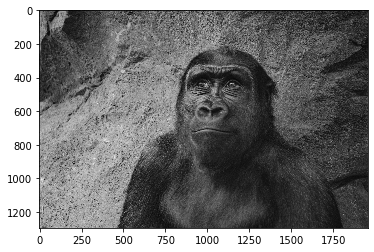

In [298]:
plt.imshow(gorilla, cmap = "gray")

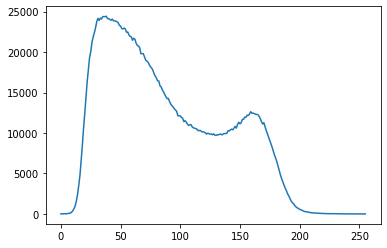

In [304]:
hist_values = cv2.calcHist([gorilla],channels=[0],mask=None,histSize=[256],ranges=[0,256])
plt.plot(hist_values)

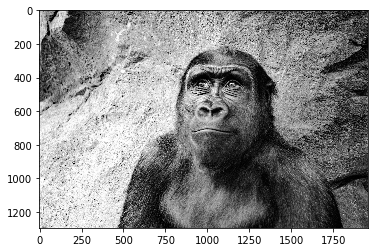

In [300]:
eq_gorilla = cv2.equalizeHist(gorilla)
plt.imshow(eq_gorilla, cmap = "gray")

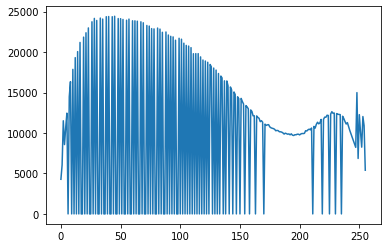

In [305]:
hist_values = cv2.calcHist([eq_gorilla],channels=[0],mask=None,histSize=[256],ranges=[0,256])
plt.plot(hist_values)

In [335]:
def display_img(img,cmap=None):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

In [336]:
image = cv2.imread("../DATA/gorilla.jpg")

In [337]:
test = image.copy()

In [356]:
for x in range(test.shape[0]):
    for y in range(test.shape[1]):
        for channel in range(3):
            if test[x][y][channel] >= 127:
                test[x][y] = np.array([255]*3)
                break
            else:
                test[x][y] = np.array([0]*3)
                break

In [ ]:
display_img(test, 'gray')

In [ ]:
grayscale = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
display_img(grayscale,'gray')

In [ ]:
rec,t1 = cv2.threshold(grayscale, 127, 255, cv2.THRESH_BINARY)
display_img(t1,'gray')

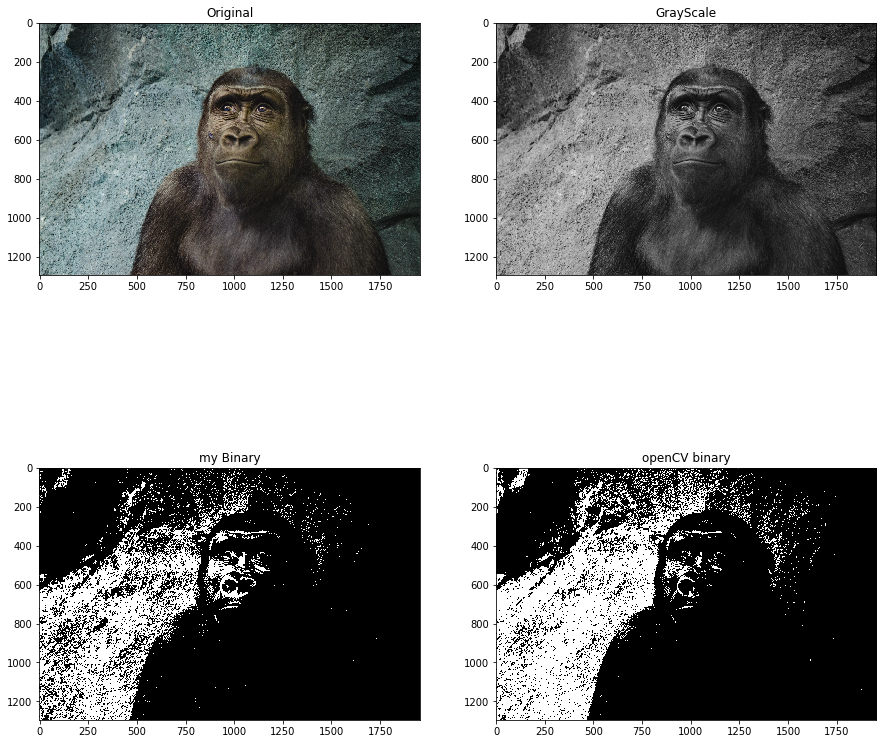

In [357]:
fig, axs = plt.subplots(2,2,figsize = (15,15))
axs[0,0].imshow(image, cmap = 'gray')
axs[0,0].title.set_text("Original")

axs[0,1].imshow(grayscale, cmap = 'gray')
axs[0,1].title.set_text("GrayScale")

axs[1,0].imshow(test, cmap = 'gray')
axs[1,0].title.set_text("my Binary")

axs[1,1].imshow(t1, cmap = 'gray')
axs[1,1].title.set_text("openCV binary")